#### Diabetes in Embedding Space - Use GRAPE for Embeddding Creation

In [1]:
cd ..

/home/dsi/rgoldner/projects/cvc


In [2]:
%load_ext autoreload
%autoreload 2

In [3]:
import os, sys
import collections
import importlib
import matplotlib
import numpy as np
import pandas as pd
from matplotlib import pyplot as plt
from matplotlib.colors import ListedColormap
import seaborn as sns
import torch_geometric
import torch
import torch.nn.functional as F
from torch_geometric.data import Data
from torch_geometric.utils import from_networkx
from torch_geometric.nn import GCNConv
from sklearn.model_selection import train_test_split
import networkx as nx

SRC_DIR = "cvc"
sys.path.append(SRC_DIR)
from child_diabetes_timepoints import diabetes_utils as du
from cvc import embbeding_wrapper as ew
from child_diabetes_timepoints import graph_utils as gu
from child_diabetes_timepoints import graph_GRAPE_utils as ggu
from cvc import utils
from lab_notebooks.utils import TRANSFORMER, DEVICE, DATA_DIR
MODEL_DIR = os.path.join(SRC_DIR, "models")
sys.path.append(MODEL_DIR)

FILT_EDIT_DIST = True

PLOT_DIR = os.path.join(os.path.dirname(SRC_DIR), "plots/CDR3_data_plots")
if not os.path.isdir(PLOT_DIR):
    os.makedirs(PLOT_DIR)
PLOT_DIR

2023-07-12 20:34:02.979025: I tensorflow/core/util/port.cc:110] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.
2023-07-12 20:34:03.053052: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 AVX512F AVX512_VNNI FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
2023-07-12 20:34:06.878414: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Could not find TensorRT
INFO:matplotlib.font_manager:Failed to extract font properties from /usr/share/fonts/google-noto-emoji/NotoColorEmoji.ttf: In FT2Font: Can not load face (unknown file format; error code 0x2)
INFO:faiss.loader:Loading faiss with AVX2 support.
INFO:fai

'plots/CDR3_data_plots'

#### Load and Process data

In [4]:
DATA_FOLDER_DIR = "/dsi/scratch/home/dsi/romiDiabetes/"

# combine files according to control/case metadata
case_samples_dir = DATA_FOLDER_DIR + "case_samples.csv"
control_samples_dir = DATA_FOLDER_DIR + "control_samples.csv"

In [5]:
# Process metadata
case_samples = du.process_diabetes_metadata(case_samples_dir)
control_samples = du.process_diabetes_metadata(control_samples_dir)

/home/dsi/rgoldner/projects/cvc/child_diabetes_timepoints/diabetes_utils.py:6: DtypeWarning: Columns (0,7,8) have mixed types. Specify dtype option on import or set low_memory=False.
  samples = pd.read_csv(directory)


In [6]:
#take out index 12 from case_samples
case_samples = case_samples.drop(12)

In [519]:
# Join data for each patient
cases_dataframes_dict = du.join_data(case_samples, DATA_FOLDER_DIR)
control_dataframes_dict = du.join_data(control_samples, DATA_FOLDER_DIR)

/home/dsi/rgoldner/projects/cvc/child_diabetes_timepoints/diabetes_utils.py:37: DtypeWarning: Columns (62) have mixed types. Specify dtype option on import or set low_memory=False.
  df_file = pd.read_csv(file_path, sep='\t', usecols=column_to_use)
/home/dsi/rgoldner/projects/cvc/child_diabetes_timepoints/diabetes_utils.py:37: DtypeWarning: Columns (62) have mixed types. Specify dtype option on import or set low_memory=False.
  df_file = pd.read_csv(file_path, sep='\t', usecols=column_to_use)
/home/dsi/rgoldner/projects/cvc/child_diabetes_timepoints/diabetes_utils.py:37: DtypeWarning: Columns (62) have mixed types. Specify dtype option on import or set low_memory=False.
  df_file = pd.read_csv(file_path, sep='\t', usecols=column_to_use)
/home/dsi/rgoldner/projects/cvc/child_diabetes_timepoints/diabetes_utils.py:37: DtypeWarning: Columns (62) have mixed types. Specify dtype option on import or set low_memory=False.
  df_file = pd.read_csv(file_path, sep='\t', usecols=column_to_use)
/hom

In [520]:
len(cases_dataframes_dict), len(control_dataframes_dict)

(28, 25)

In [ ]:
from tqdm import tqdm
# apply the parse_tags function to all dataframes that divides the sample_catalog_tags column into multiple columns
def apply_parse_tags(cases_dataframes_dict):
    for patient_id in tqdm(cases_dataframes_dict.keys()):
        dataframes_list = cases_dataframes_dict[patient_id]
        for i, df in enumerate(dataframes_list):
            dataframes_list[i] = df.join(df['sample_catalog_tags'].apply(du.parse_tags))
            # change cdr3_amino_acid column name to Sequences
            dataframes_list[i].rename(columns={'cdr3_amino_acid': 'Sequences'}, inplace=True)
            # change j_gene column to be all strings
            dataframes_list[i]['j_gene'] = dataframes_list[i]['j_gene'].astype(str)
    return cases_dataframes_dict

cases_dataframes_dict = apply_parse_tags(cases_dataframes_dict)
control_dataframes_dict = apply_parse_tags(control_dataframes_dict)

 28%|████████████████████████████████████▉                                                                                               | 7/25 [12:34<34:12, 114.05s/it]

#### Create and Display embeddings

In [ ]:
from lab_notebooks.utils import DEVICE
DEVICE

In [ ]:
from cvc.embbeding_wrapper import EmbeddingWrapper
def create_sample_embeddings(patient_data, TRANSFORMER, DEVICE, batch_size=1024, method="mean", layers=[-1]):
    patient_embeddings_list = []
    for patient_sample_data in patient_data:
        embed_wrap = EmbeddingWrapper(TRANSFORMER, DEVICE, patient_sample_data, batch_size=batch_size, method=method, layers=layers)
        patient_embeddings_list.append(embed_wrap)
    return patient_embeddings_list

In [ ]:
def create_all_patient_embeddings(cases_dataframes_dict, TRANSFORMER, DEVICE, batch_size=1024, method="mean", layers=[-1]):
    patient_embeddings_dict = {}
    for key in cases_dataframes_dict.keys():
        patient_embeddings_dict[key] = create_sample_embeddings(cases_dataframes_dict[key], TRANSFORMER, DEVICE, batch_size, method, layers)
    return patient_embeddings_dict

In [ ]:
case_patient_embeddings_dict = create_all_patient_embeddings(cases_dataframes_dict, TRANSFORMER, DEVICE)

In [ ]:
control_patient_embeddings_dict = create_all_patient_embeddings(control_dataframes_dict, TRANSFORMER, DEVICE)

#### Graph Embedding Creation (Initial Method) and Analysis

In [ ]:
GRAPH_DIR = "/dsi/scratch/home/dsi/romiDiabetes/graphs_dir"

In [ ]:
case_graph_embeddings_dict = gu.create_patient_graph_embeddings(case_patient_embeddings_dict, cases_dataframes_dict, 'case')

In [ ]:
control_graph_embeddings_dict = gu.create_patient_graph_embeddings(control_patient_embeddings_dict, control_dataframes_dict, 'case')

In [ ]:
case_ages_dict = gu.create_age_dict(cases_dataframes_dict)
control_ages_dict = gu.create_age_dict(control_dataframes_dict)

#### Create GRAPE embeddings

##### Create GRAPE Embeddings using different embedding methods and plot

In [ ]:
case_GRAPE_embeddings_dict = ggu.create_GRAPE_embeddings_2(case_patient_embeddings_dict, cases_dataframes_dict, 'case', embedder_function=ggu.Node2VecSkipGramEnsmallen)
graph = case_GRAPE_embeddings_dict['0_0']['graph']
embeddings = case_GRAPE_embeddings_dict['0_0']['embeddings']
ggu.plot_node_types_umap(graph, embeddings, k=13, plot_type='ALL', decomposition_method='TSNE')

Creating GRAPE embeddings


Processing patients: 100%|██████████████████████████████| 1/1 [18:53<00:00, 1133.67s/it]


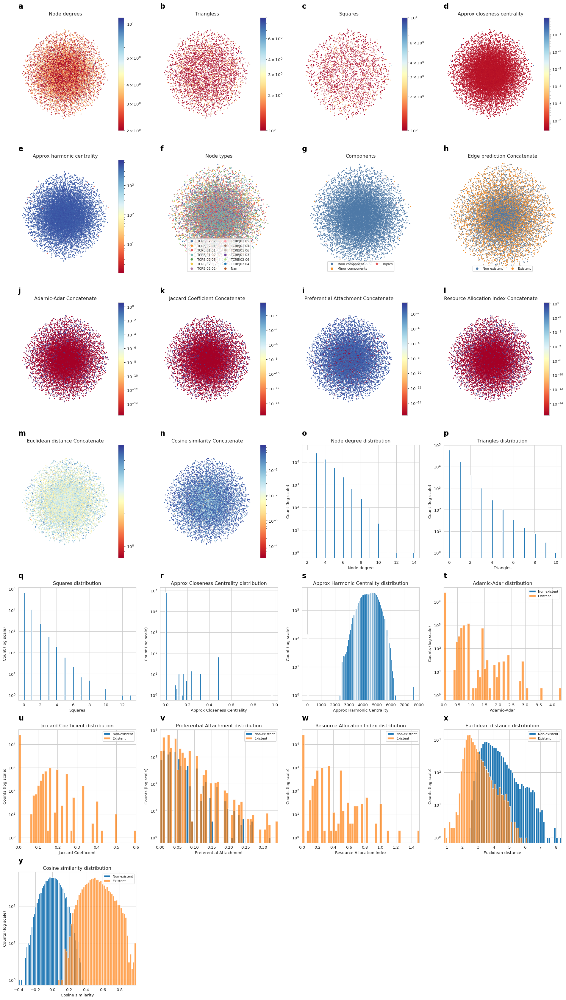

In [72]:
case_GRAPE_embeddings_dict = ggu.create_GRAPE_embeddings_2(case_patient_embeddings_dict, cases_dataframes_dict, 'case', embedder_function=gu.Node2VecGloVeEnsmallen)
graph = case_GRAPE_embeddings_dict['0_0']['graph']
embeddings = case_GRAPE_embeddings_dict['0_0']['embeddings']
ggu.plot_node_types_umap(graph, embeddings, k=13, plot_type='ALL', decomposition_method='TSNE')

Creating GRAPE embeddings


Processing patients: 100%|███████████████████████████████| 1/1 [10:11<00:00, 611.45s/it]


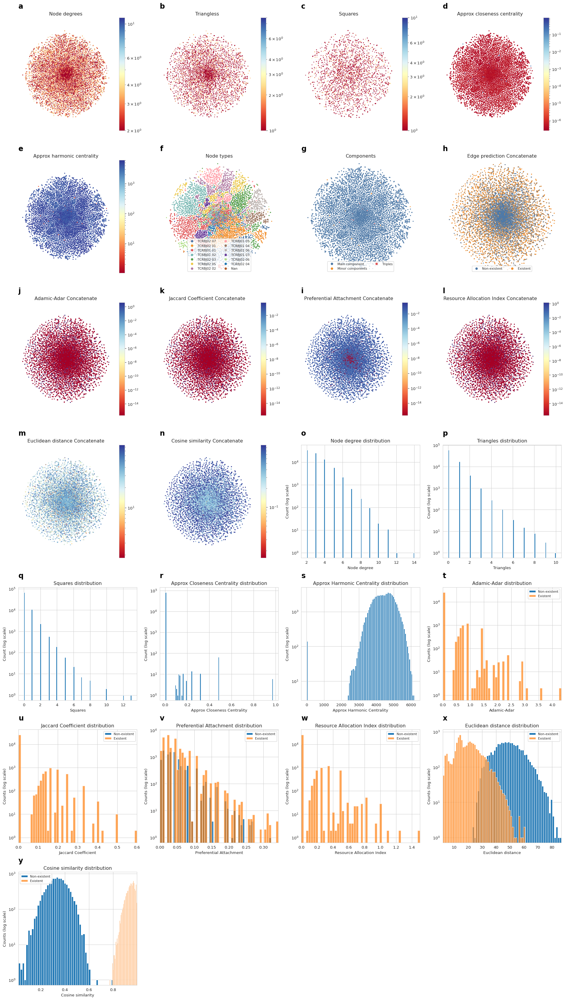

In [74]:
case_GRAPE_embeddings_dict = gu.create_GRAPE_embeddings_2(case_patient_embeddings_dict, cases_dataframes_dict, 'case', embedder_function=gu.Node2VecCBOWEnsmallen)
graph = case_GRAPE_embeddings_dict['0_0']['graph']
embeddings = case_GRAPE_embeddings_dict['0_0']['embeddings']
ggu.plot_node_types_umap(graph, embeddings, k=13, plot_type='ALL', decomposition_method='TSNE')

Creating GRAPE embeddings


Processing patients: 100%|███████████████████████████████| 1/1 [10:26<00:00, 626.43s/it]


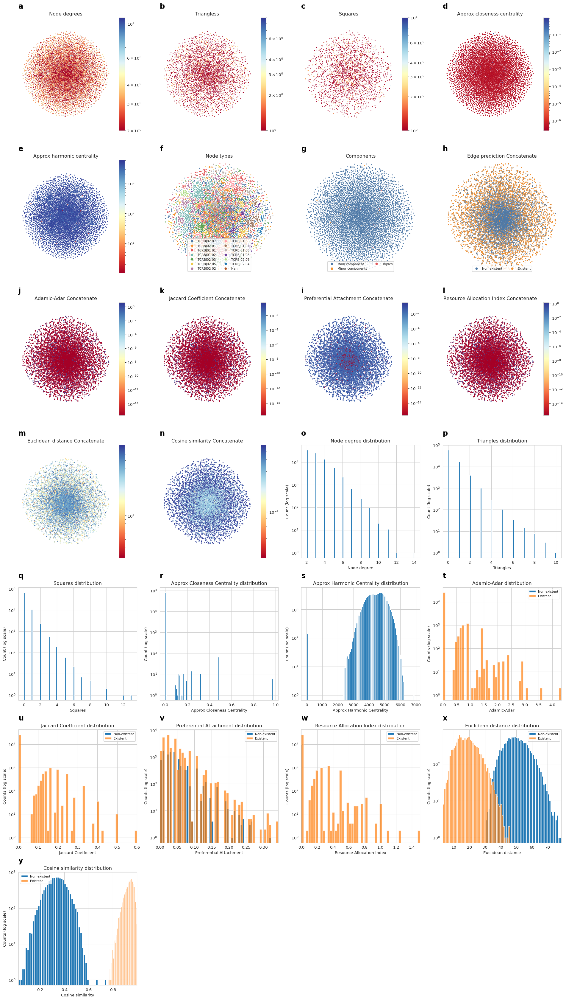

In [82]:
case_GRAPE_embeddings_dict = gu.create_GRAPE_embeddings_2(case_patient_embeddings_dict, cases_dataframes_dict, 'case', embedder_function=gu.DeepWalkCBOWEnsmallen)
graph = case_GRAPE_embeddings_dict['0_0']['graph']
embeddings = case_GRAPE_embeddings_dict['0_0']['embeddings']
ggu.plot_node_types_umap(graph, embeddings, k=13, plot_type='ALL', decomposition_method='TSNE')

Creating GRAPE embeddings


Processing patients: 100%|███████████████████████████████| 1/1 [11:49<00:00, 709.13s/it]


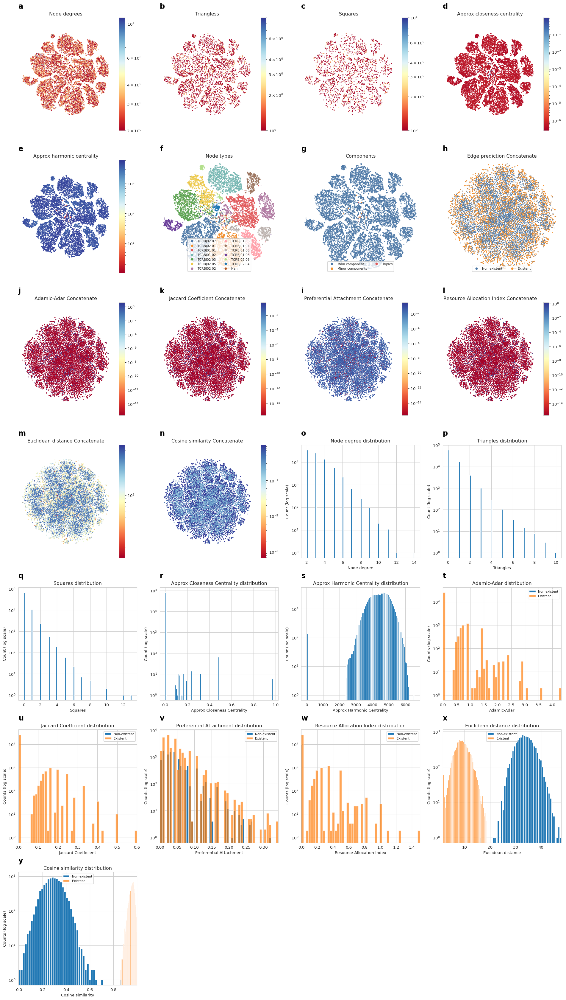

In [83]:
case_GRAPE_embeddings_dict = ggu.create_GRAPE_embeddings_2(case_patient_embeddings_dict, cases_dataframes_dict, 'case', embedder_function=gu.DeepWalkSkipGramEnsmallen)
graph = case_GRAPE_embeddings_dict['0_0']['graph']
embeddings = case_GRAPE_embeddings_dict['0_0']['embeddings']
ggu.plot_node_types_umap(graph, embeddings, k=13, plot_type='ALL', decomposition_method='TSNE')

Creating GRAPE embeddings


Processing patients: 100%|███████████████████████████████| 1/1 [07:53<00:00, 473.41s/it]


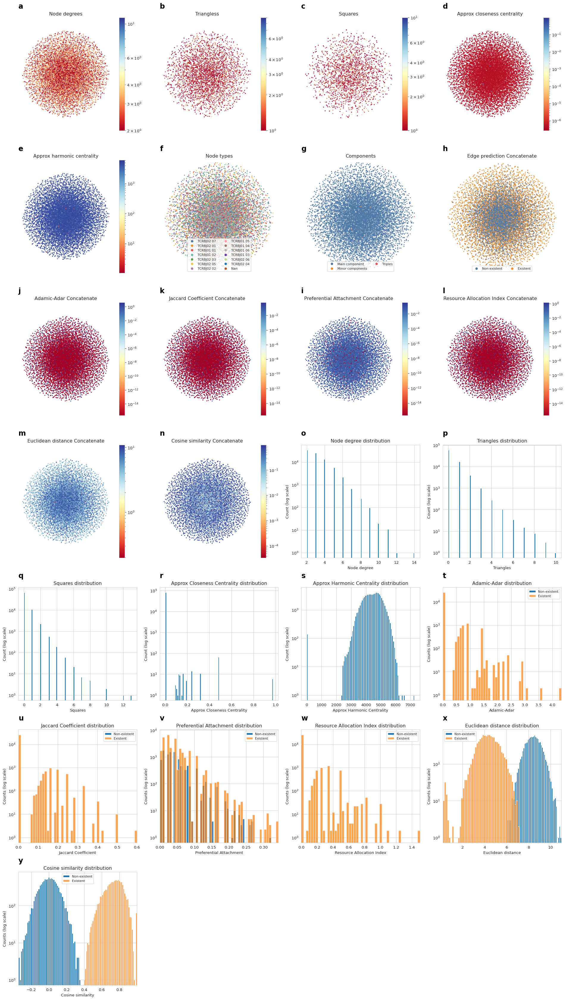

In [84]:
case_GRAPE_embeddings_dict = gu.create_GRAPE_embeddings_2(case_patient_embeddings_dict, cases_dataframes_dict, 'case', embedder_function=gu.DeepWalkGloVeEnsmallen)
graph = case_GRAPE_embeddings_dict['0_0']['graph']
embeddings = case_GRAPE_embeddings_dict['0_0']['embeddings']
ggu.plot_node_types_umap(graph, embeddings, k=13, plot_type='ALL', decomposition_method='TSNE')

#### Create GRAPE embeddings for timepoints

##### Prepare data - join timepoint embeddings and sequences

In [98]:
import child_diabetes_timepoints.graph_GRAPE_utils as ggu

In [135]:
# Join timepoint embeddings and sequences - cases
case_timepoint_embeddings_dict, case_timepoint_sequences_dict = ggu.create_timepoint_embeddings(case_patient_embeddings_dict)
# create the graph embeddings
case_timepoint_GRAPE_embeddings_dict = ggu.create_GRAPE_embeddings_timepoints(case_timepoint_embeddings_dict, case_timepoint_sequences_dict, embedder_function=ggu.Node2VecSkipGramEnsmallen)

Creating GRAPE embeddings


Processing timepoints: 100%|██████████████████████████| 4/4 [2:29:25<00:00, 2241.47s/it]


In [146]:
# Join timepoint embeddings and sequences - control
control_timepoint_embeddings_dict, control_timepoint_sequences_dict = ggu.create_timepoint_embeddings(control_patient_embeddings_dict)

# create the graph embeddings - control
control_timepoint_GRAPE_embeddings_dict = ggu.create_GRAPE_embeddings_timepoints(control_timepoint_embeddings_dict, control_timepoint_sequences_dict, embedder_function=ggu.Node2VecSkipGramEnsmallen)

Creating GRAPE embeddings


Processing timepoints: 100%|██████████████████████████| 4/4 [3:05:28<00:00, 2782.15s/it]


##### Plot the embedding

###### Cases

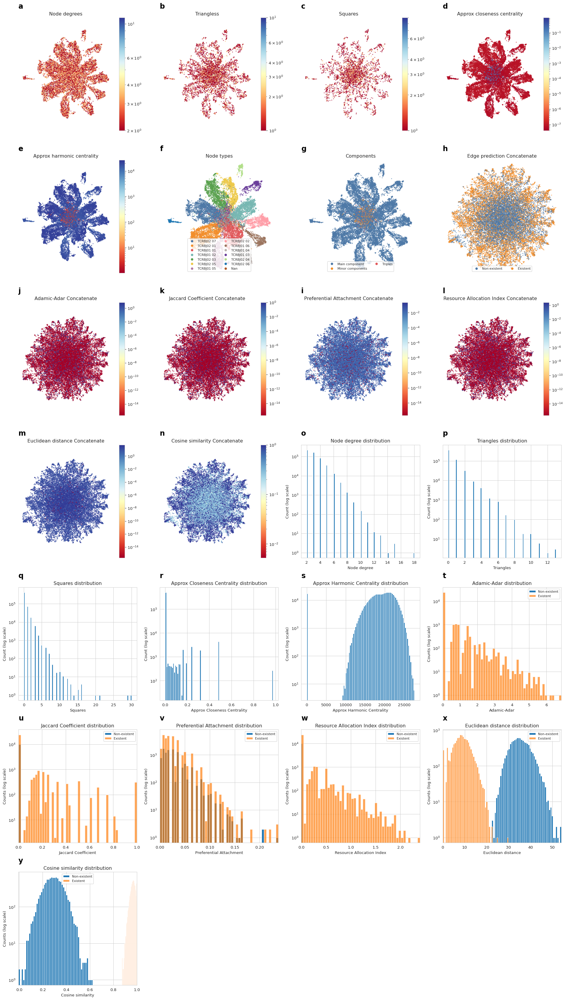

In [152]:
# Timepoint 0
graph = case_timepoint_GRAPE_embeddings_dict['0']['graph']
embeddings = case_timepoint_GRAPE_embeddings_dict['0']['embeddings']
ggu.plot_node_types_umap(graph, embeddings, k=13, plot_type='ALL', decomposition_method='UMAP')

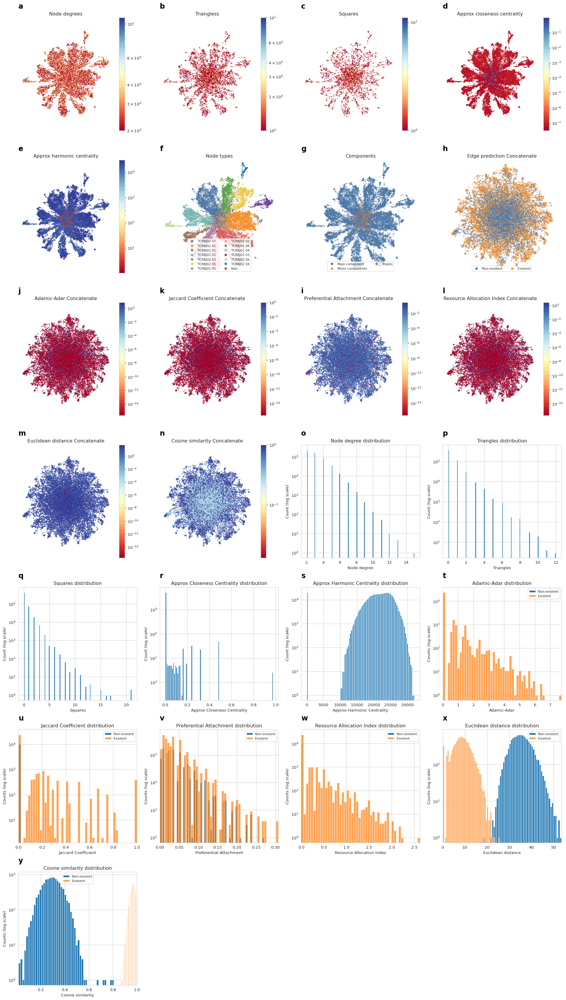

In [153]:
# Timepoint 1
graph = case_timepoint_GRAPE_embeddings_dict['1']['graph']
embeddings = case_timepoint_GRAPE_embeddings_dict['1']['embeddings']
ggu.plot_node_types_umap(graph, embeddings, k=13, plot_type='ALL', decomposition_method='UMAP')

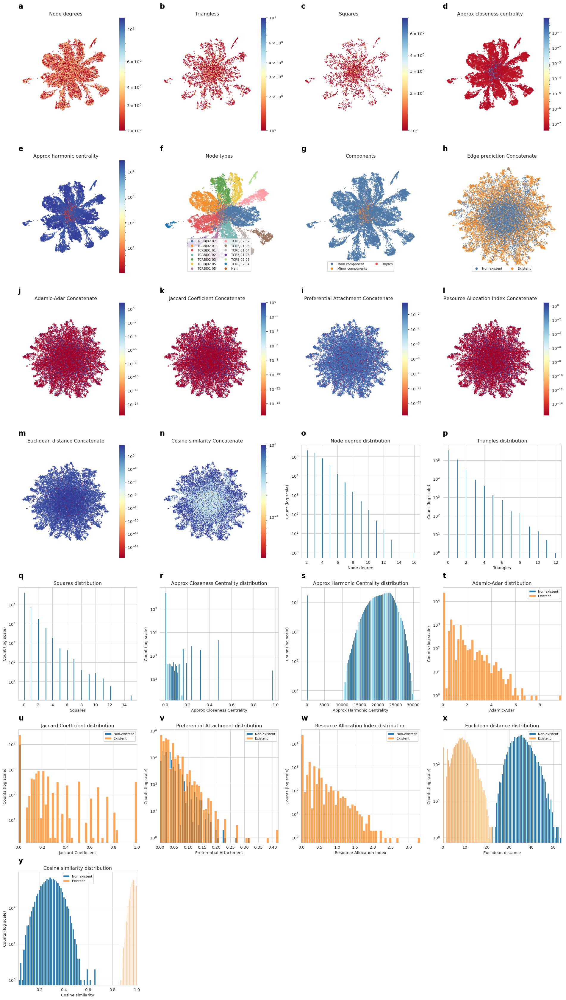

In [154]:
# Timepoint 2
graph = case_timepoint_GRAPE_embeddings_dict['2']['graph']
embeddings = case_timepoint_GRAPE_embeddings_dict['2']['embeddings']
ggu.plot_node_types_umap(graph, embeddings, k=13, plot_type='ALL', decomposition_method='UMAP')

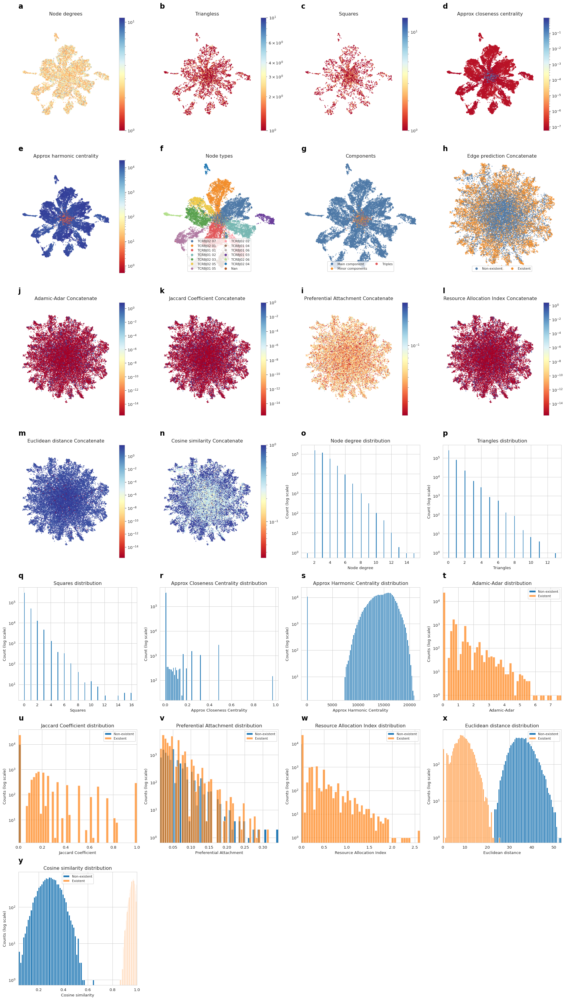

In [155]:
# Timepoint 3
graph = case_timepoint_GRAPE_embeddings_dict['3']['graph']
embeddings = case_timepoint_GRAPE_embeddings_dict['3']['embeddings']
ggu.plot_node_types_umap(graph, embeddings, k=13, plot_type='ALL', decomposition_method='UMAP')

###### Control

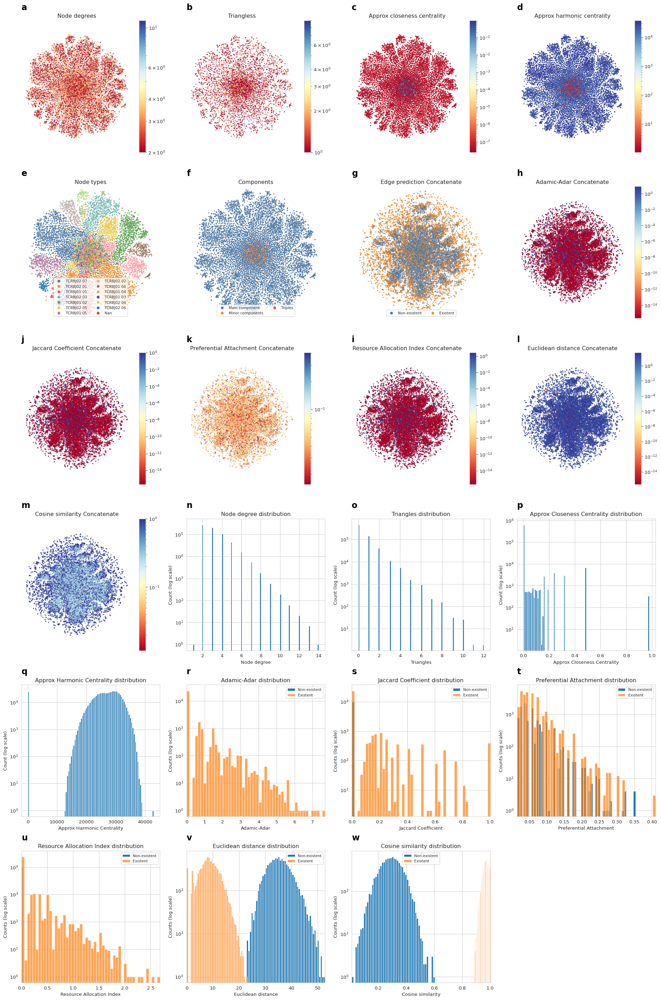

In [158]:
# Timepoint 0
graph = control_timepoint_GRAPE_embeddings_dict['0']['graph']
embeddings = control_timepoint_GRAPE_embeddings_dict['0']['embeddings']
ggu.plot_node_types_umap(graph, embeddings, k=13, plot_type='ALL', decomposition_method='TSNE')

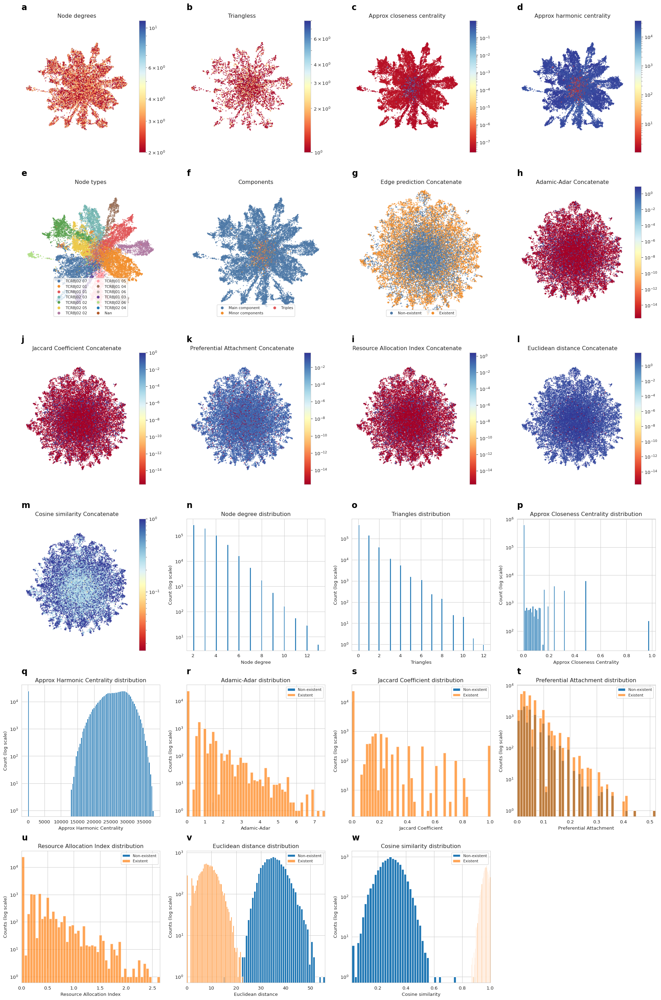

In [157]:
# Timepoint 1
graph = control_timepoint_GRAPE_embeddings_dict['1']['graph']
embeddings = control_timepoint_GRAPE_embeddings_dict['1']['embeddings']
ggu.plot_node_types_umap(graph, embeddings, k=13, plot_type='ALL', decomposition_method='UMAP')

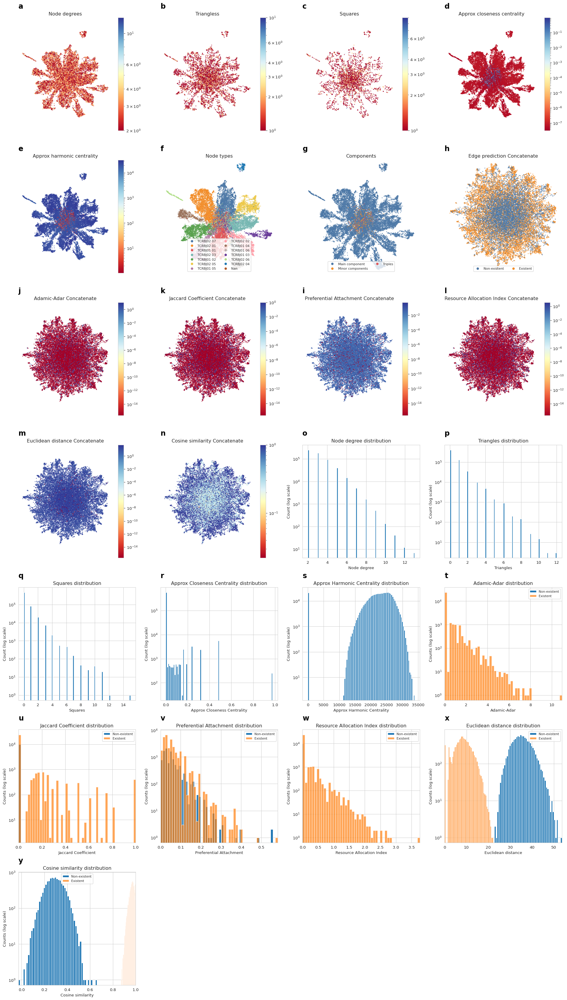

In [159]:
# Timepoint 2
graph = control_timepoint_GRAPE_embeddings_dict['2']['graph']
embeddings = control_timepoint_GRAPE_embeddings_dict['2']['embeddings']
ggu.plot_node_types_umap(graph, embeddings, k=13, plot_type='ALL', decomposition_method='UMAP')

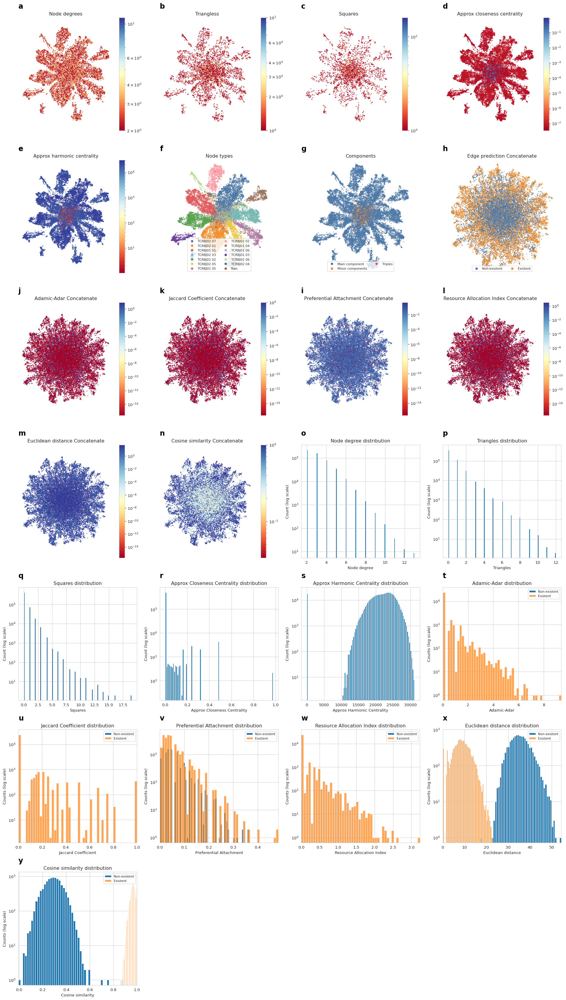

In [160]:
# Timepoint 3
graph = control_timepoint_GRAPE_embeddings_dict['3']['graph']
embeddings = control_timepoint_GRAPE_embeddings_dict['3']['embeddings']
ggu.plot_node_types_umap(graph, embeddings, k=13, plot_type='ALL', decomposition_method='UMAP')